In [1]:
%%capture
import matplotlib.pyplot as plt
import numpy as np
import cv2

try: cv2.setNumThreads(0)
except: pass
from caiman import movie
import os
# %matplotlib inline
%config InlineBackend.figure_format = 'retina'

import pandas as pd
from itertools import product
from collections import OrderedDict

from sys import path as syspath
syspath.append(os.path.expanduser("~/srdjan_functs/"))
from matplotlib.colors import LogNorm
from collections import Counter

import plotly_express as plx

In [2]:
%load_ext autoreload
%autoreload 1
%aimport Regions, physio_def_1, numeric

In [3]:
from physio_def_1 import *
from numeric import *

# Importing

In [9]:
npzFiles = [
# #     "local_data/Sandra/2020_01_14/Experiment45b/Experiment45b_1_Series006.npz",
# #     "local_data/Sandra/2020_01_14/Experiment45b/Experiment45b_2_Series007.npz",
# #     "local_data/Sandra/2020_01_14/Experiment45b/Experiment45b_3_Series008.npz"
#     "local_data/Sandra/2020_01_14/Experiment45c/Experiment45c_1_Series003.npz",
#     "local_data/Sandra/2020_01_14/Experiment45c/Experiment45c_2_Series004.npz",
#     "local_data/Sandra/2019_10_15/Experiment38b/Experiment38b_23_Series061.npz",
    "local_data/Sandra/2019_09_03/",
    Experiment31_Series041

#     "local_data/Old/Pancreas_islet_OGB_56/Pancreas_islet_OGB_56_13_Series020.npz"
#     "local_data/Old/ExperimentOGB/ExperimentOGB_28_Series032.npz"
# #     "local_data/testdir/Experiment38a_7_Series016.npz"
]

In [10]:
# date = "2019_10_15"
# exp = "Experiment38a"
# series = "Series016"

# npzFolder = f"local_data/Sandra/{date}/{exp}/"
# npzFiles = sorted([npzFolder+f for f in os.listdir(npzFolder) if series in f and f.endswith("npz") and "motcor" not in f])

In [11]:
metadata = pd.DataFrame([pd.read_csv(npzFile.replace("npz","txt")).loc[0] for npzFile in npzFiles])

if len(metadata)>1:
    assert metadata.X.std()==0
    assert metadata.Y.std()==0
    assert metadata.freq.std()/metadata.freq.mean()<1e-3
    print ((metadata["T"]/metadata["freq"]/60).sum(), "minutes")
    origFreq = metadata.freq.mean()
    metadata["T"] = metadata["T"].sum()
    metadata = pd.Series(metadata.iloc[0])
    metadata["freq"] = origFreq
else:
    metadata = metadata.iloc[0]
    origFreq = metadata.freq
    print (metadata["T"]/metadata.freq/60, "minutes")

baseName = getBaseName(npzFiles)

if os.path.isfile(baseName+"_motcor.npz"):
    npzFile = baseName+"_motcor.npz"
    npzFileHandle = np.load(npzFile)
    template = npzFileHandle["template"]
    m_orig = movie(npzFileHandle['data'])
else:
    orig_images = import_npz_files(npzFiles)
    m_orig = movie(orig_images.astype("float32"))
    del orig_images
m_orig.fr = origFreq

15.80913104911166 minutes


In [12]:
allTrace = m_orig.mean(axis=(1,2))

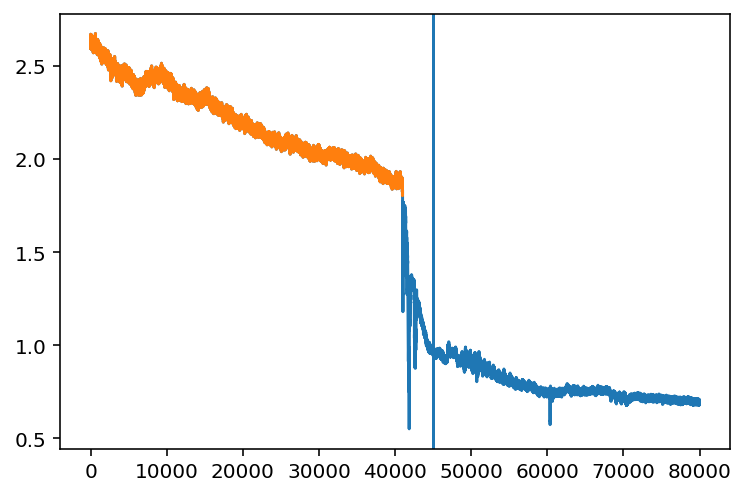

In [13]:
plt.plot(allTrace)
iStop = np.where(allTrace<1.8)[0][0]
plt.plot(allTrace[:iStop])
plt.axvline(45000)

<IPython.core.display.Javascript object>


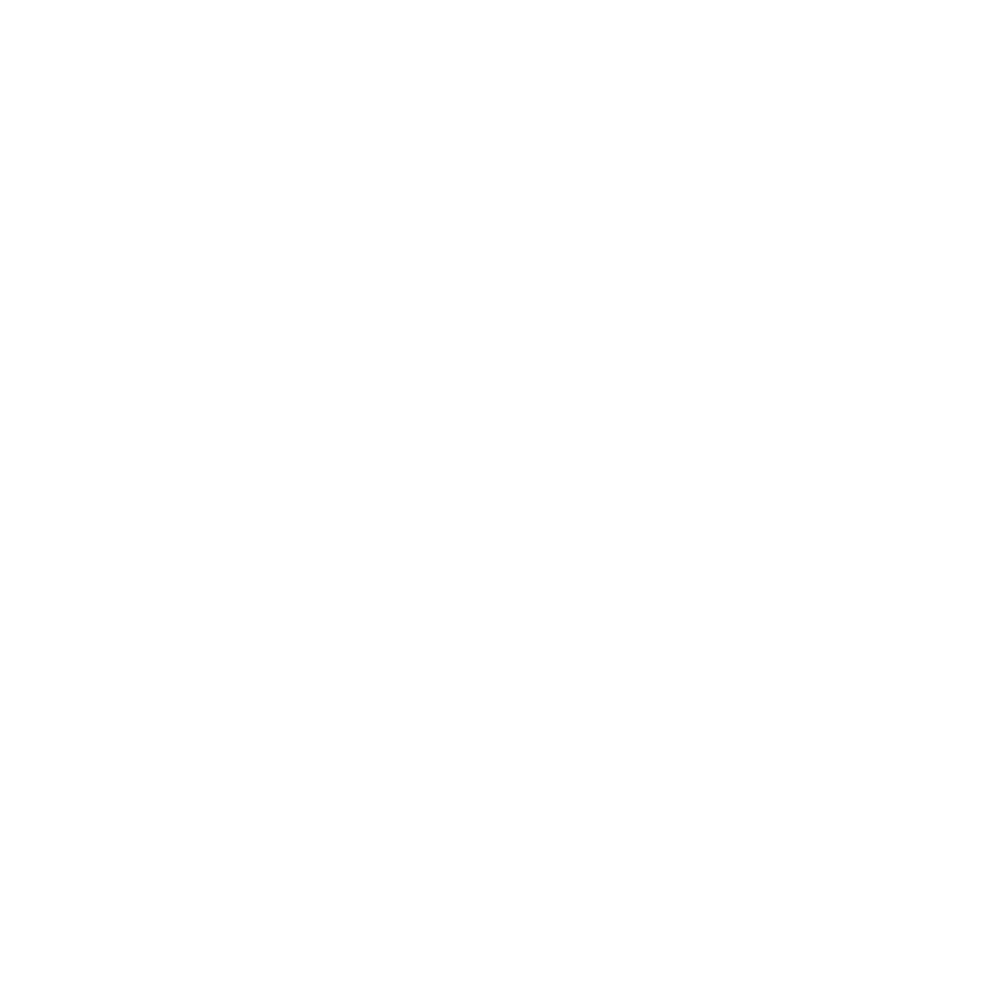

In [272]:
showMovie(m_orig,)

In [23]:
# prepare m_analys for faster analysis.
# (For final presentation we can always go back to original movie.)
# if we DO NOT want to take shortcuts, commend all after "First"
m_analysis = m_orig[:iStop].astype("float")

# First, introduce some gaussian blur
# m_analysis.gaussian_blur_2D(3,3,.5,.5);

# Then, resample to lower frequency (for analyses downstream to go much faster)
newFreq = 2
n_rebin = int(m_orig.fr/newFreq)
if n_rebin<2:
    n_rebin = 1
    m_analysis = m_orig.astype(float)
else:
    m_analysis = rebin(m_analysis,n_rebin, norm=False)
    m_analysis.fr = m_orig.fr/n_rebin

In [24]:
import Regions

In [25]:
cell_halfwidth_in_px = int(5./metadata.pxSize)

In [26]:
regions = Regions.Regions(m_analysis,
                          gSig_filt=(cell_halfwidth_in_px,)*2
                         )
regions.purge_lones(cell_halfwidth_in_px**2)

Initialized with 704 rois.
deleted 77 rois. 627 remain.


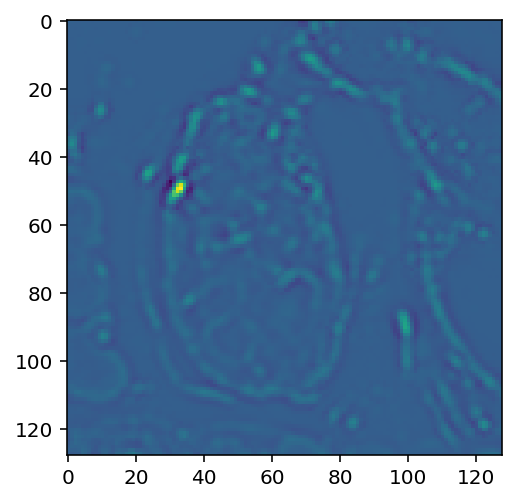

In [27]:
plt.imshow(regions.image,)

Text(0, 0.5, 'count')

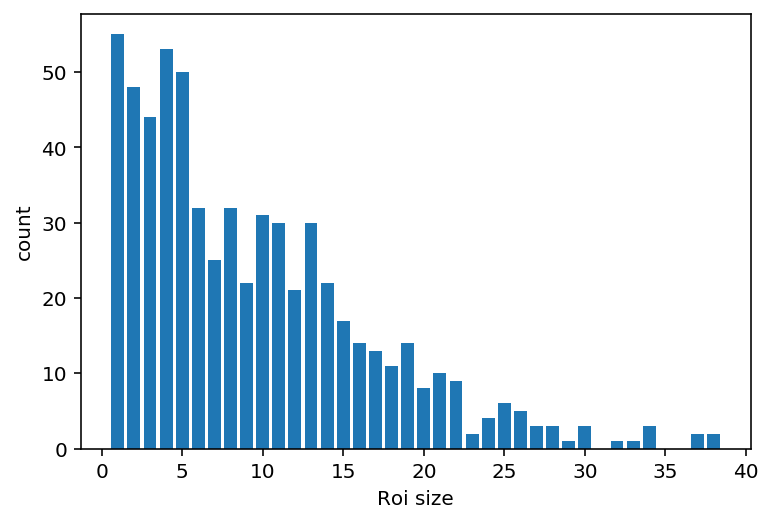

In [28]:
x = regions.df["size"].value_counts().sort_index()
plt.bar(x.keys(),x)
plt.xlabel("Roi size")
plt.ylabel("count")

In [29]:
regions.df.drop(index=regions.df.query("size<=5").index, inplace=True)

In [30]:
regions.calcTraces()

(377, 975)


In [31]:
regions.df["trace_median"] = regions.df.trace.apply(np.median)
regions.df["trace_max"]    = regions.df.trace.apply(np.max)

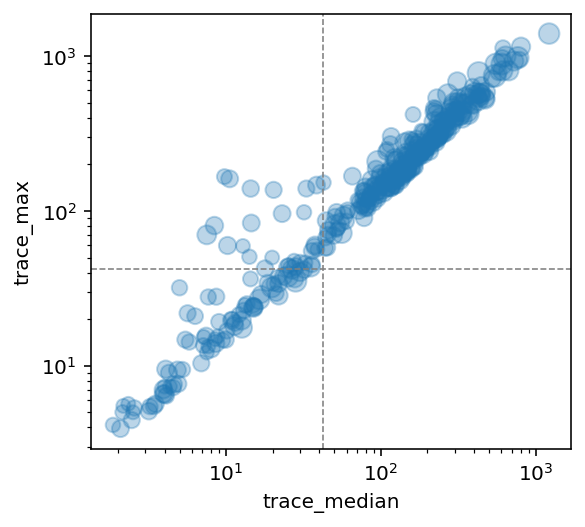

In [32]:
# regions.df.plot("trace_median","trace_max",kind="hexbin",xscale="log",yscale="log",mincnt=1,bins="log",cmap="hot",gridsize=(30,20))
regions.df.plot("trace_median","trace_max",kind="scatter",s=regions.df["size"]**.5*20,alpha = .3)
plt.axhline(n_rebin,ls="--",color="grey",lw=.8)
plt.axvline(n_rebin,ls="--",color="grey",lw=.8)
plt.xscale("log")
plt.yscale("log")
plt.gca().set_aspect("equal")

In [33]:
toDel = regions.df.query(f"trace_max<{n_rebin/2}").index
if len(toDel):
    yesNo = input(f"are you sure you wish to remove these {len(toDel)} rois?")
    if yesNo.lower()[0]=="y":
        regions.df.drop(inplace=True,index=toDel)
        print (f"{len(regions.df)} remain.")

are you sure you wish to remove these 48 rois?y
329 remain.


In [34]:
C = regions.df

Text(0, 0.5, 'count')

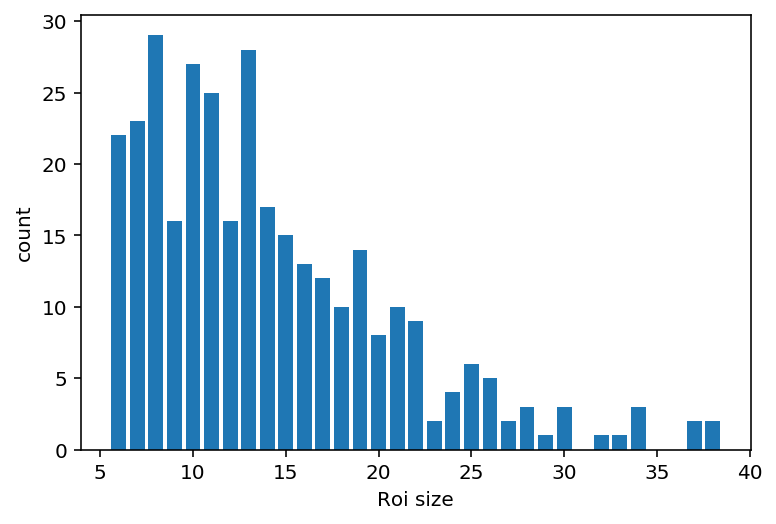

In [35]:
x = C['size'].value_counts().sort_index()
plt.bar(x.keys(),x)
plt.xlabel("Roi size")
plt.ylabel("count")

In [36]:
minSize = 10

In [37]:
toDel = regions.df.query(f"size<{minSize}").index
if len(toDel):
    yesNo = input(f"are you sure you wish to remove these {len(toDel)} rois?")
    if yesNo.lower()[0]=="y":
        regions.df.drop(inplace=True,index=toDel)
        print (f"{len(regions.df)} remain.")

are you sure you wish to remove these 90 rois?y
239 remain.


# Filtering and further

In [38]:
ironScale = 10 # in sec
wIron = int(ironScale*m_analysis.fr)
if wIron%2==0:
    wIron += 1
print(wIron)
filterPars = (wIron,wIron,50.,2)

21


In [39]:
%%capture
# this is only to instantiate compiled functions so they complain less further down
x = regions.df["trace"].iloc[0][:3*wIron]
lowPass   (x,*filterPars)
runningStd(x,wIron)

In [40]:
from general_functions import multi_map

In [41]:
def iterf(x_):
    return lowPass(x_,*filterPars)

C["slower_%g"%ironScale] = multi_map(iterf,C["trace"].values,processes=15)

In [42]:
C["faster_%g"%ironScale] = [C.loc[i,"trace"] - C.loc[i,"slower_%g"%ironScale] for i in C.index]

In [43]:
def iterf(x_):
    mad2std = 1.4826
    out = mad2std*percFilter(np.abs(x_),50.,wIron)
    out = runningAverage(out,wIron)
    return out

C["faster_%g_std_mad"%ironScale] = multi_map(iterf,C["faster_%g"%ironScale].values,processes=15)

In [44]:
# plotting definition
def plotInteresting(investigateIndex_,
                    onlyImage=False,
                    figsize = (10,10),
                    std=True,
                    time=None
                   ):
    fig, axs = plt.subplots(1,2,figsize=[figsize[0],figsize[1]/2], sharex=True, sharey=True)
    axs[-1].remove()
#     for ax,im in zip(axs,["std_0_dbl","template"]):
#         try:
#             showImage = images[im].astype("float")
#         except:
#             continue
#         if "std" in im:
#             ax.imshow(.01+showImage,cmap="Greys",norm=LogNorm(),vmax=showImage.max()*10)
#         else:
#             x = np.arctan(30*showImage)
#             v = np.percentile(np.abs(x),99)*4
#             im = ax.imshow(x,cmap="bwr", vmin=-v, vmax=v)
    ax = axs[0]
    x = regions.image
    ax.imshow(x,cmap="bwr", vmin=-10, vmax=10)
    regions.plotEdges(ix=investigateIndex_,separate=True,image=False, ax=ax)
    regions.plotPeaks(ix=investigateIndex_,image=False, ax=ax,labels=True)
    fig.show()
    
    if onlyImage: return None

    fig, axs = plt.subplots(2,1,figsize=figsize, sharex=True)
    ia = 0
    n = 1
    ns = 2

    # inax = inset_axes(axs[0],
    #                     width="30%", # width = 30% of parent_bbox
    #                     height=1.2, # height : 1 inch
    #                     loc=2)
    # showImage = images["std_dres"].astype("float")
    # inax.imshow(.1+showImage,cmap="Greys",norm=LogNorm(),vmax=showImage.max()*10)
    # regions.plotEdges(ix=investigateIndex_,separate=True,ax=inax)
    if time is None:
        i = investigateIndex_[0]
        time = np.arange(C.loc[i,"trace"])
    t = rebin(time,n)
    for roi in investigateIndex_:
        x  = rebin(C.loc[roi,"trace"],n)
        xf = rebin(C.loc[roi,valName],n)
        xsd= rebin(C.loc[roi,stdName],n)/n**.5
        xs = rebin(C.loc[roi,valName.replace("faster","slower")],n)
        if "posRender" in globals():
            eventFilter = posRender[np.where(C.index==roi)[0][0]]

        xsd= xsd/xf.std()
        xf = xf/xf.std()

        c  = "C%i"%(roi%10)
        axs[0].plot(t,x [::],c=c,lw=.4,alpha = .3)
        axs[0].plot(t,xs[::],c=c,lw=.7,alpha = 1)
        if "posRender" in globals():
            axs[0].plot(t[eventFilter],xs[eventFilter],".",c=c,ms=2,alpha = .2)
        yoffset = 5*ia
        axs[1].plot(t,xf[::]+yoffset,c=c,lw=.3)
        if std:
            axs[1].plot(t,+ns*xsd[::]+yoffset,c=c,lw=.7)
            axs[1].plot(t,-ns*xsd[::]+yoffset,c=c,lw=.7)
        axs[1].axhline(yoffset,color=c,label=roi,lw=.5)
        axs[1].text(0,yoffset,str(roi)+" ",fontdict={"color":c},ha="right",va="center")
        axs[0].text(0,xs[0],str(roi)+" ",fontdict={"color":c},ha="right",va="center")
    # axs[1].legend(loc=(1.01,.01))
    # #     x,y = C.loc[roi,"peak"]#np.mean(C.loc[i,"pixels"],axis=0)
    # #     inax.plot(x,y,"o",mfc="none",ms=C.loc[i,"size"]**.5/2,c=c,mew=.3)
    #     bb = list(C.loc[roi,"boundary"])
    #     bb += [bb[0]]
    #     x,y = np.array(bb).T
    #     inax.plot(x,y,c=c,lw=.5)
        ia += 1
    # yl = axs[0].get_ylim()[1]
    # axs[0].set_ylim(None,yl*1.2)

    # plt.xticks([])
    # plt.yticks([])
    fig.tight_layout()
    fig.show()

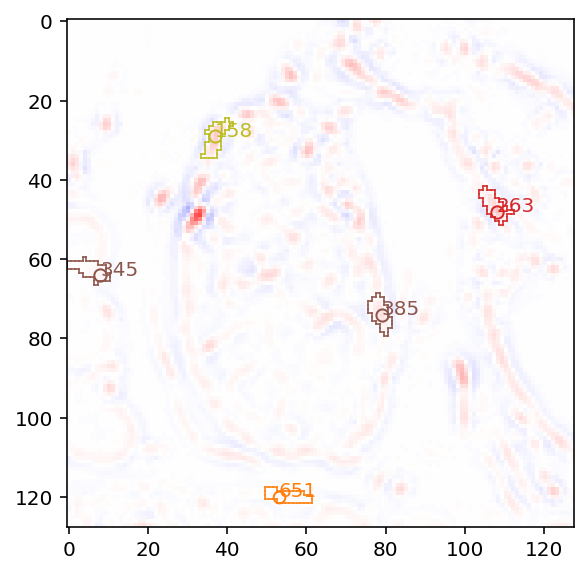

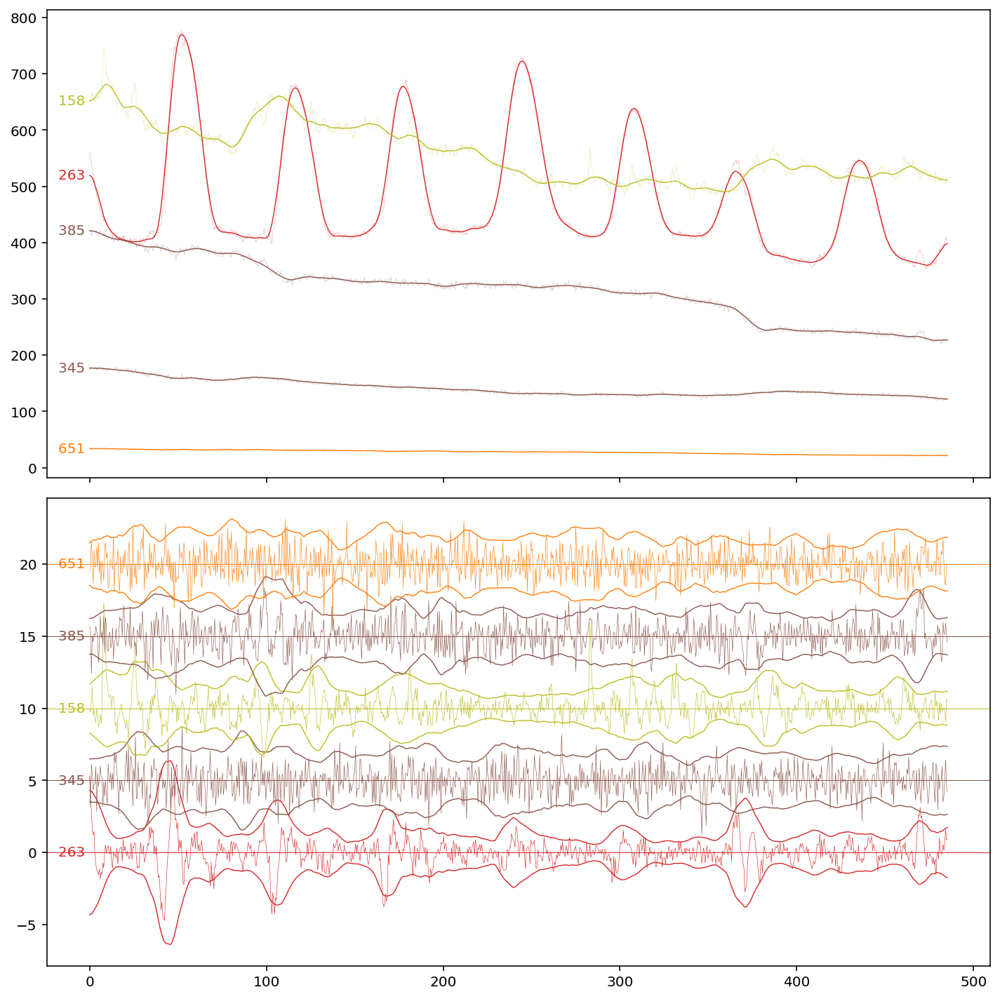

In [45]:
valName = "faster_%g"%ironScale
stdName = "faster_%g_std_mad"%ironScale
plotInteresting(C.sort_values("size",ascending=False).index[:5],time=regions.time)

In [131]:
regions.update(m_orig)

(239, 79967)


## Better filters

In [213]:
def multiFilter(x, filterSeq, ):
    ironedx = np.zeros_like(x)
    for iFilter,filter_ in filterSeq.iterrows():
        f = eval(filter_.function)
        kw_args = {k:filter_[k] for k in filter_.keys() if k not in ["function","filterSize","postAverage"] and np.isfinite(filter_[k])}
#         print (kw_args)
        if "nbins" in kw_args:
            kw_args["nbins"] = int(kw_args["nbins"])
        ironedx += f(x-ironedx, filterSize = filter_.filterSize,**kw_args)
        if filter_.postAverage is not None and filter_.postAverage>1:
            ironedx = runningAverage(ironedx,filter_.postAverage)
    return ironedx

In [255]:
i = 158#C.sort_values("size",ascending=False).index[0]
x = C.loc[i,"trace"][:].copy()

In [256]:
t = regions.time[:len(x)]

In [257]:
wIron = int(10*regions.movie.fr)
if not wIron%2: wIron += 1
wIron

843

In [258]:
fls = pd.DataFrame(columns=["function","filterSize","perc","postAverage"])
fls = fls.append({"function":"percFilter","filterSize":wIron,"perc":10,"postAverage":wIron},ignore_index=True)
fls = fls.append({"function":"percFilter","filterSize":wIron,"perc":10,"postAverage":wIron},ignore_index=True)
fls = fls.append({"function":"runningMode","filterSize":wIron,"nbins":30,"postAverage":wIron},ignore_index=True)
# fls = fls.append({"function":"runningAverage","filterSize":11,"postAverage":21},ignore_index=True)
# fls["filterSize"] = fls["filterSize"].astype(int)
# fls["nbins"] = fls["nbins"].astype(int)

In [260]:
%matplotlib notebook

<IPython.core.display.Javascript object>


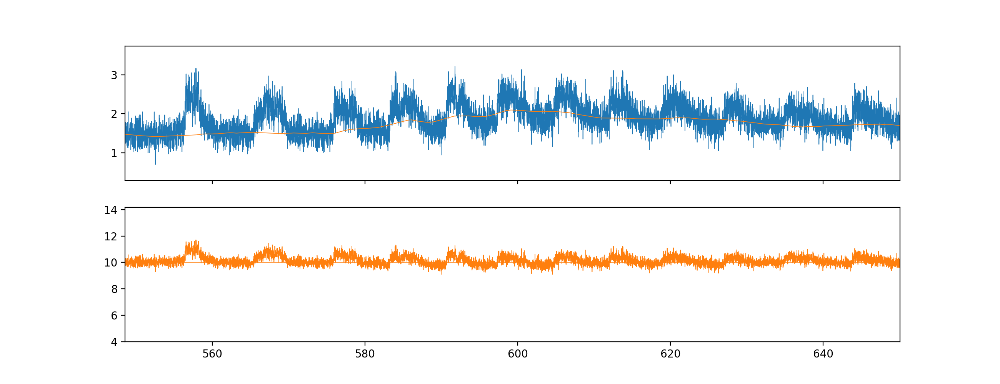

In [261]:
fig, axs = plt.subplots(2,1,figsize=(13,5), sharex=True)
axs[0].plot(t,x,lw=.6)
axs[1].plot([])
for i in range(len(fls))[-1:]:
    xf = multiFilter(x,fls.iloc[:i+1])
    axs[0].plot(t,xf,lw=.6)
    dx = x-xf
    offset = i*5
    c = axs[1].plot(t,dx+offset,lw=.6)[0].get_color()
    axs[1].axhline(offset,lw=.6,c=c)
# dxf = runningMode(dx,1*wIron,30)
# axs[1].plot(t,dxf,lw=.6)
# t0 = 0
# i0 = np.where(t>t0)[0][0]
# plt.axvline(t0)
# plt.axvline(t[i0+wIron])
# axs[1].plot(t,runningMode(x-xf,3*wIron,30))
plt.show()

# subx = x[i0:i0+wIron]
# plt.hist(subx,40);
# plt.plot(sorted(subx), np.linspace(0,1,wIron))
# plt.plot(
#     sorted(subx)[:-1], 1./np.diff(sorted(subx))
#         )

In [ ]:
plt.

# Investigate results

In [263]:
# valName = "faster_%g"%ironScale
# stdName = "faster_%g_std_mad"%ironScale
stdMin = np.maximum(1e-9,np.vstack(C[stdName]).min()/10)
zscore = np.vstack(C[valName])/(stdMin+np.vstack(C[stdName]))


zth = 2.5
negRender = zscore<-zth
posRender = zscore>+zth

C["negZmean"] = negRender.mean(axis=1)
C["posZmean"] = posRender.mean(axis=1)

offset = C["negZmean"][C["negZmean"]>0].min()
C["negZmean"] += offset
C["posZmean"] += offset

tmp = C["slower_%g"%ironScale].apply(np.mean)
C["logSlowMean"] = np.log10(tmp + tmp[tmp>0].min()/10)

C["lognegZmean"] = np.log10(C["negZmean"])
C["logposZmean"] = np.log10(C["posZmean"])
rndscale = .05
C["logposZmean"] += np.random.randn(len(C))*rndscale
C["lognegZmean"] += np.random.randn(len(C))*rndscale

In [264]:
decentSize = (6/metadata.pxSize)**2

In [265]:
tooLow_negZmean = np.percentile(C.negZmean,2)

In [266]:
investigateIndex = C.query(f"size>{decentSize} and negZmean>{tooLow_negZmean}").sort_values("posZmean").index[-10:]
investigateIndex = investigateIndex[::-1]
# investigateIndex = np.concatenate([[272,649,599,580], investigateIndex])
print (len(investigateIndex))
C['invest'] = [1 if i in investigateIndex else 0 for i in C.index]

10


In [267]:
plx.scatter(C,"lognegZmean","logposZmean",size="size",
#            log_x=True,log_y=True,
           hover_name=C.index,
           color=None if "invest" not in C else C["invest"],
#            color=C["logSlowMean"],
#            facet_col="invest",
           height=600,width=700,
           marginal_x="histogram",
           marginal_y="histogram",
          )

In [268]:
# plt.plot(C['size']+.6*(np.random.rand(len(C))-.5),C['posZmean'],".")

In [269]:
regions.update(m_analysis)

(239, 975)


<IPython.core.display.Javascript object>


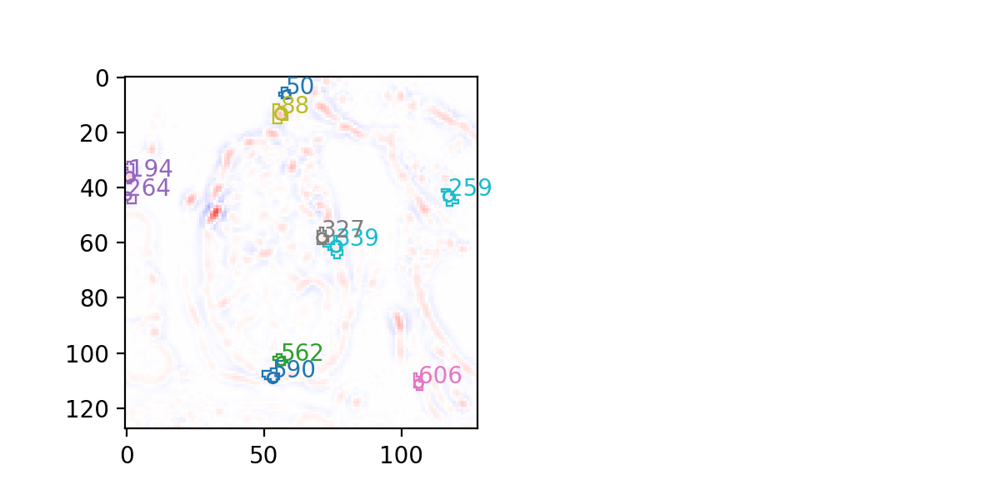

<IPython.core.display.Javascript object>


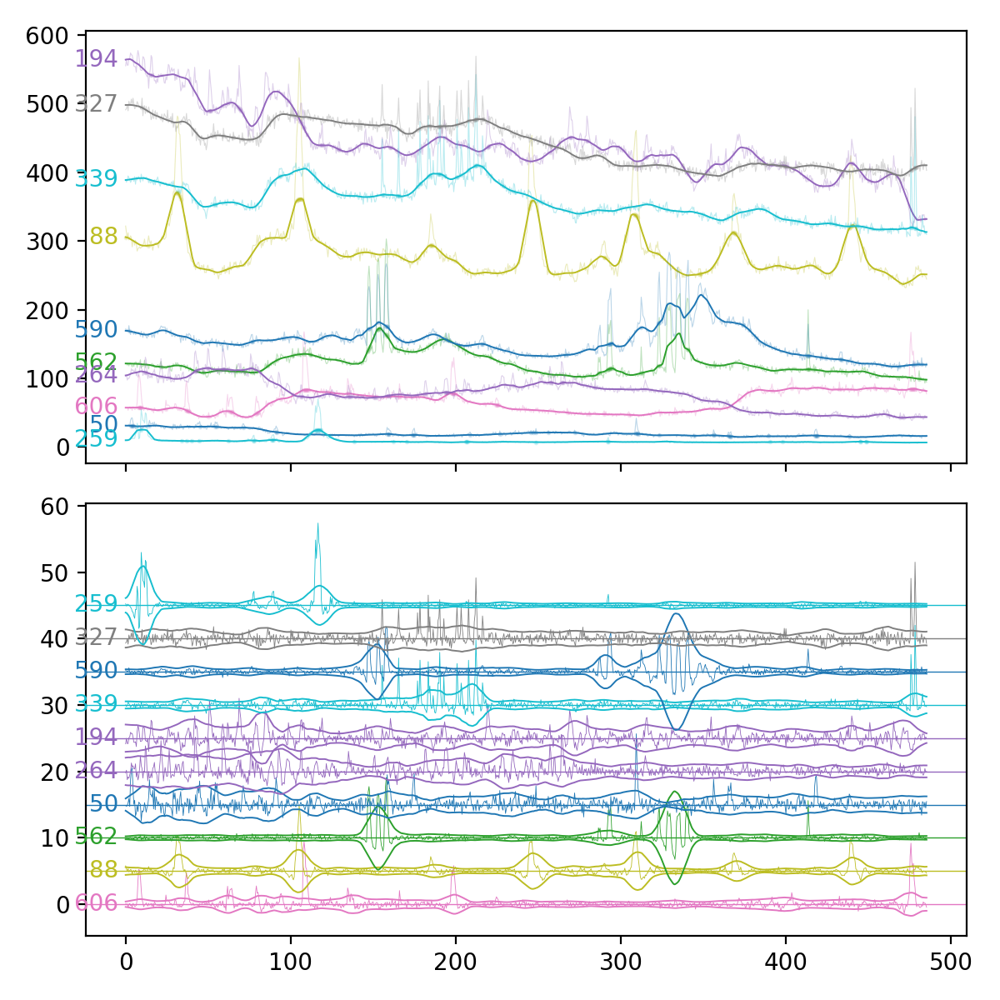

In [271]:
plotInteresting(investigateIndex,time=regions.time, figsize=(6,6))

# Some other plot(s)

In [55]:
time = np.arange(len(m_analysis))/m_analysis.fr

/home/jupyter-srdjan/srdjan_functs/numeric.py:13: RuntimeWarning:

divide by zero encountered in log



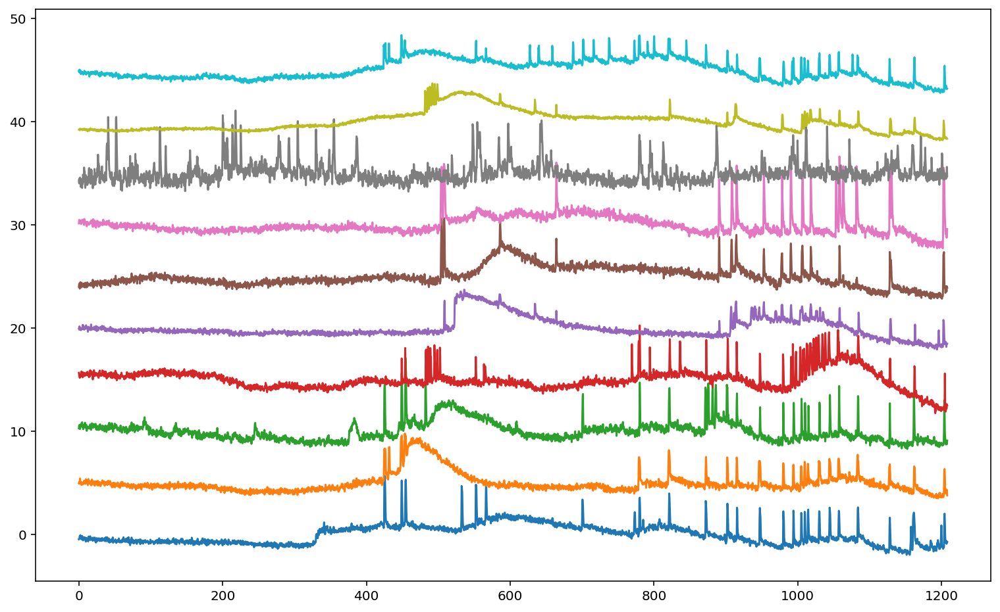

In [56]:
timeSlice = slice(0,3000)
t = time[timeSlice]
plt.figure(figsize=(13,8))
for ia,i in enumerate(investigateIndex):
    x = C.loc[i,"trace"][timeSlice]
    xd = mydebleach(x)
    x = x-xd
    x = (x-x.mean())/x.std()
    plt.plot(t,x+5*ia)

In [ ]:
%matplotlib notebook

In [ ]:
plotInteresting(investigateIndex[:],
#                 onlyImage=True
               )

## save

In [592]:
# plt.figure()
# plt.hist(np.diff(np.where(eventFilter)[0]))

In [594]:
regionSaveName = baseName+"_regions.pkl"

In [595]:
import pickle

In [597]:
regions.std_dres_image = images["std_dres"].astype(float)

In [601]:
if os.path.isfile(regionSaveName):
    print (regionSaveName, "exists. Please choose a different name.")
else:
    with open(regionSaveName,"wb") as f:
        pickle.dump(regions,f)

In [602]:
regionSaveName

'local_data/Sandra/2020_01_14/Experiment45b/Experiment45b_1_Series006-008_regions.pkl'

# Show Movie

In [35]:
timeSlice = slice(
    int(len(m_orig)*0.0),  # in percentages
    int(len(m_orig)*0.1)   # in percentages
)

nTimeFrames = 200
nRebinShow = len(m_orig[timeSlice])//nTimeFrames
border = np.ones((nTimeFrames,1,m_orig.shape[-1]))*m_orig.max()
m2show = rebin(m_orig[timeSlice].astype(np.float32), nRebinShow)

In [36]:
showMovie(np.log(.1+m2show),figsize=(13,6))